# Estatística Descritiva

Média, mediana, moda, desvio padrão, gráficos de dispersão e correlação

In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import math
from matplotlib import pyplot as plt
import seaborn as sns
import warnings
from itertools import chain

warnings.filterwarnings("ignore", category=FutureWarning)
sns.set()
pd.set_option('display.max_columns', None)

In [2]:
df = pd.read_csv('../dataset_limpo/survey_results_public_clean.csv', sep=',', encoding='utf-8')
df.head()

,Unnamed: 0,ResponseId,MainBranch,Employment,RemoteWork,CodingActivities,EdLevel,LearnCode,LearnCodeOnline,LearnCodeCoursesCert,YearsCode,YearsCodePro,DevType,OrgSize,Country,Currency,GrossWage,WageFreq,LanguageHaveWorkedWith,LanguageWantToWorkWith,DatabaseHaveWorkedWith,DatabaseWantToWorkWith,PlatformHaveWorkedWith,PlatformWantToWorkWith,WebframeHaveWorkedWith,WebframeWantToWorkWith,MiscTechHaveWorkedWith,MiscTechWantToWorkWith,ToolsTechHaveWorkedWith,ToolsTechWantToWorkWith,NEWCollabToolsHaveWorkedWith,NEWCollabToolsWantToWorkWith,OpSysProfessionalUse,OpSysPersonalUse,VersionControlSystem,VCInteraction,OfficeStackAsyncHaveWorkedWith,OfficeStackAsyncWantToWorkWith,OfficeStackSyncHaveWorkedWith,OfficeStackSyncWantToWorkWith,Blockchain,SOVisitFreq,Age,Gender,Trans,Sexuality,Ethnicity,Accessibility,MentalHealth,ICorPM,WorkExp,TimeSearching,TimeAnswering,ProfessionalTech,YearlyWageInDollar,YearsCodeNumber,YearsCodeProNumber
0,0,1,none,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
1,1,2,dev,employed_full_time,remote,hobby;open_source,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,canada,CAD,NaN,NaN,JavaScript;TypeScript,Rust;TypeScript,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,macOS,Windows Subsystem for Linux (WSL),Git,NaN,NaN,NaN,NaN,NaN,Very unfavorable,daily,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
2,2,3,part_dev,employed_full_time,hybrid,hobby,master,books;someone;other_online_resources,technical_documentation;blogs;programming_game...,NaN,14,5,data_scientist_or_machine_learning_specialist;...,20 to 99 employees,united_kingdom_of_great_britain_and_northern_i...,GBP,32000.0,Yearly,C#;C++;HTML/CSS;JavaScript;Python,C#;C++;HTML/CSS;JavaScript;TypeScript,Microsoft SQL Server,Microsoft SQL Server,NaN,NaN,Angular.js,Angular;Angular.js,Pandas,.NET,NaN,NaN,Notepad++;Visual Studio,Notepad++;Visual Studio,Windows,Windows,Git,Code editor,NaN,NaN,Microsoft Teams,Microsoft Teams,Very unfavorable,multiple_day,25-34 years old,man,no,bisexual,white,none,emotional;anxiety,NaN,NaN,NaN,NaN,NaN,40205.0,14.0,5.0
3,3,4,dev,employed_full_time,remote,i_dont_code_outside_of_work,bachelor,books;school,NaN,NaN,20,17,developer_full_stack,100 to 499 employees,israel,ILS,60000.0,Monthly,C#;JavaScript;SQL;TypeScript,C#;SQL;TypeScript,Microsoft SQL Server,Microsoft SQL Server,NaN,NaN,ASP.NET;ASP.NET Core,ASP.NET;ASP.NET Core,.NET,.NET,NaN,NaN,Notepad++;Visual Studio;Visual Studio Code,Notepad++;Visual Studio;Visual Studio Code,Windows,Windows,Git,Code editor;Command-line;Version control hosti...,Jira Work Management;Trello,Jira Work Management;Trello,Slack;Zoom,Slack;Zoom,Very unfavorable,daily,35-44 years old,man,no,heterosexual,white,none,none,NaN,NaN,NaN,NaN,NaN,215232.0,20.0,17.0
4,4,5,dev,employed_full_time,hybrid,hobby,bachelor,other_online_resources;job,technical_documentation;blogs;stack_overflow;o...,NaN,8,3,developer_front_end;developer_full_stack;devel...,20 to 99 employees,united_states_of_america,USD,NaN,NaN,C#;HTML/CSS;JavaScript;SQL;Swift;TypeScript,C#;Elixir;F#;Go;JavaScript;Rust;TypeScript,Cloud Firestore;Elasticsearch;Microsoft SQL Se...,Cloud Firestore;Elasticsearch;Firebase Realtim...,Firebase;Microsoft Azure,Firebase;Microsoft Azure,Angular;ASP.NET;ASP.NET Core ;jQuery;Node.js,Angular;ASP.NET Core ;Blazor;Node.js,.NET,.NET;Apache Kafka,npm,Docker;Kubernetes,Notepad++;Visual Studio;Visual Studio Code;Xcode,Rider;Visual Studio;Visual Studio Code,Windows,macOS;Windows,Git;Other (please specify):,Code editor,NaN,NaN,Microsoft Teams;Zoom,NaN,Unfavorable,multiple_day,25-34 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.0,3.0


## Salário

Salário anual em dólar.

In [3]:
df['YearlyWageInDollar'].mean()

170761.2778492816

In [4]:
df['YearlyWageInDollar'].describe()

count    3.807100e+04
mean     1.707613e+05
std      7.814132e+05
min      1.000000e+00
25%      3.583200e+04
50%      6.784500e+04
75%      1.200000e+05
max      5.000000e+07
Name: YearlyWageInDollar, dtype: float64

### Por idade

Conseguimos observar que o salário tende a aumentar com a idade.

In [5]:
bg_wage_age_order = {
  'Age': [
    'Under 18 years old',
    '18-24 years old',
    '25-34 years old',
    '35-44 years old',
    '45-54 years old',
    '55-64 years old',
    '65 years or older',
    'opt_out'
  ]
}
bg_wage_age = px.box(df, x='YearlyWageInDollar', y='Age', log_x=True, category_orders=bg_wage_age_order)
bg_wage_age.show()

No gráfico abaixo, podemos observar que o salário anual em dólar tende a aumentar com a quantidade de anos de experiência profissional na área, porém os dados ficam instáveis após a marca de US$200 mil.

In [6]:
df_wage_exp = df[df['Country'] == 'united_states_of_america']
df_wage_exp = df_wage_exp[df_wage_exp['YearsCodeProNumber'] > 0]
df_wage_exp = df_wage_exp[df_wage_exp['YearlyWageInDollar'] > 10000]

bg_wage_exp = px.scatter(df_wage_exp, x='YearlyWageInDollar', y='YearsCodeProNumber', trendline='lowess', log_x=True, trendline_color_override='#0547cb')
bg_wage_exp.show()

## Experiência profissional x experiência profissional com programação

Como esperado, a experiência profissional tende a correlacionar com a experiência profissional com programação.

In [7]:
bg_wage_exp = px.scatter(df, x='WorkExp', y='YearsCodeProNumber', trendline='lowess')
bg_wage_exp.show()

## Experiência profissional com programação x experiência com programação

Também esperado, a experiência com programação tende a correlacionar com a experiência profissional com programação.

In [8]:
bg_wage_exp = px.scatter(df, x='YearsCodeNumber', y='YearsCodeProNumber', trendline='lowess')
bg_wage_exp.show()

## Tempo no StackOverflow

### Pesquisando soluções

#### Por anos de experiência

Podemos observar que pessoas com mais experiência em programação tendem a gastar menos tempo pesquisando soluções para problemas.

In [9]:
bg_searching_exp_order = {
  'TimeSearching': [
    'Less than 15 minutes a day',
    '15-30 minutes a day',
    '30-60 minutes a day',
    '60-120 minutes a day',
    'Over 120 minutes a day',
  ]
}
bg_searching_exp = px.box(df, x='YearsCodeNumber', y='TimeSearching', category_orders=bg_searching_exp_order)
bg_searching_exp.show()

#### Por anos de experiência profissional

O mesmo ocorre para pessoas com mais experiência _profissional_ em programação.

In [10]:
bg_searching_exp_pro = px.box(df, x='YearsCodeProNumber', y='TimeSearching', category_orders=bg_searching_exp_order)
bg_searching_exp_pro.show()

### Respondendo perguntas

#### Por anos de experiência

Aqui observamos o inverso, onde pessoas com mais experiência em programação tendem a gastar mais tempo respondendo perguntas no StackOverflow.

In [11]:
bg_answering_exp_order = {
  'TimeAnswering': [
    'Less than 15 minutes a day',
    '15-30 minutes a day',
    '30-60 minutes a day',
    '60-120 minutes a day',
    'Over 120 minutes a day',
  ]
}
bg_answering_exp = px.box(df, x='YearsCodeNumber', y='TimeAnswering', category_orders=bg_searching_exp_order)
bg_answering_exp.show()

#### Por anos de experiência profissional

O mesmo ocorre para pessoas com mais experiência _profissional_ em programação.

In [12]:
bg_answering_exp_pro = px.box(df, x='YearsCodeProNumber', y='TimeAnswering', category_orders=bg_searching_exp_order)
bg_answering_exp_pro.show()

## Correlação

Podemos observar que há uma forte correlação positiva entre anos de experiência profissional e anos de experiência em programação, como esperado. Também podemos observar que não há muita correlação entre esta experiência e o salário, talvez pela grande diversidade de países que participaram da pesquisa.

<AxesSubplot:>

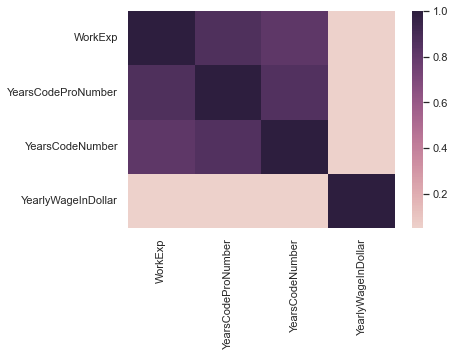

In [13]:
df_subset = df[['WorkExp', 'YearsCodeProNumber', 'YearsCodeNumber','YearlyWageInDollar']].copy()
df_subset_corr = df_subset.corr()

cmap = sns.cubehelix_palette(as_cmap=True)
sns.heatmap(df_subset_corr,cmap=cmap)